In [18]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from IPython.display import HTML, display
import tabulate
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split
import csv
from sklearn.metrics import roc_curve, auc

In [19]:
!ls

dataunderstandingkagg.py  drive  sample_data  train_set.csv


In [20]:
df=pd.read_csv('train_set.csv')
df.head(5)

,ID,var3,var15,imp_ent_var16_ult1,imp_op_var39_comer_ult1,imp_op_var39_comer_ult3,imp_op_var40_comer_ult1,imp_op_var40_comer_ult3,imp_op_var40_efect_ult1,imp_op_var40_efect_ult3,...,saldo_medio_var33_hace2,saldo_medio_var33_hace3,saldo_medio_var33_ult1,saldo_medio_var33_ult3,saldo_medio_var44_hace2,saldo_medio_var44_hace3,saldo_medio_var44_ult1,saldo_medio_var44_ult3,var38,TARGET
0,1,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,39205.170000,0
1,3,2,34,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,49278.030000,0
2,4,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,67333.770000,0
3,8,2,37,0.0,195.0,195.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,64007.970000,0
4,10,2,39,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,117310.979016,0


- **Checking and dropping the outliers**

In [21]:
def drop_outliers(df, z_threshold=3):
  """
  This function takes a DataFrame and a z-score threshold and returns a new DataFrame with the outliers removed.

  Args:
    df: The DataFrame to remove outliers from.
    z_threshold: The z-score threshold to use for outlier detection.

  Returns:
    A new DataFrame with the outliers removed.
  """

  # Calculate the z-scores for each column
  z_scores = np.abs((df - df.mean()) / df.std())

  # Identify the outliers
  outliers = df[(z_scores > z_threshold).any(axis=1)]

  # Remove the outliers
  df_no_outliers = df.drop(outliers.index)

  return df_no_outliers


# **Data Cleaning and Preperation for Machine Learning**


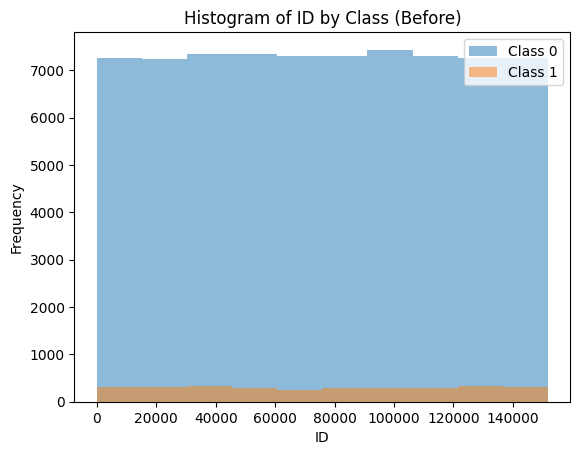

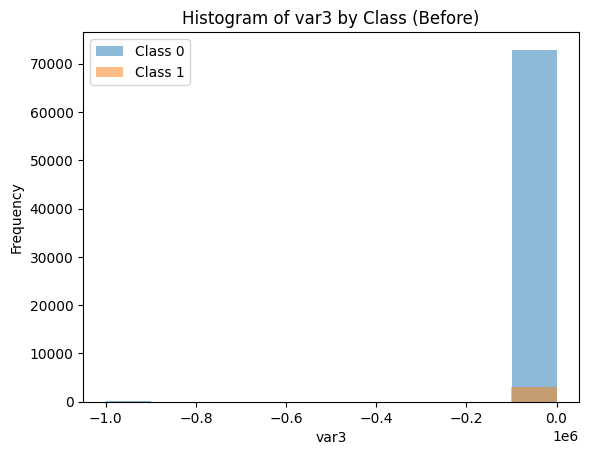

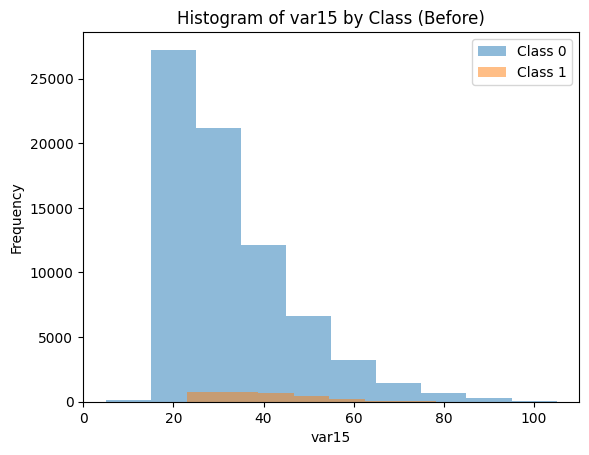

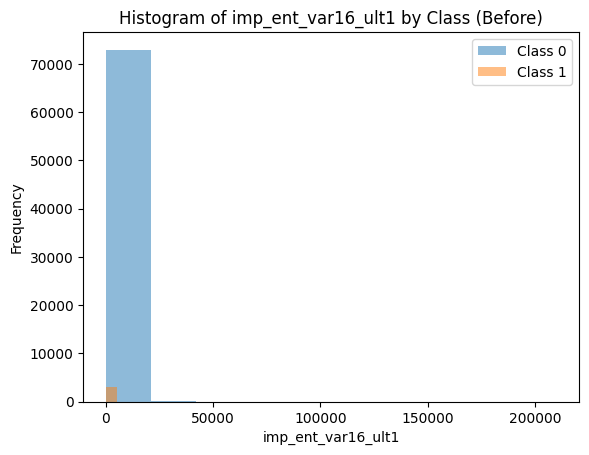

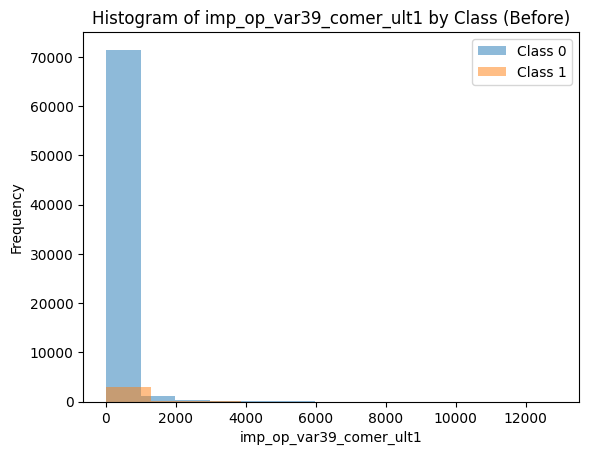

...

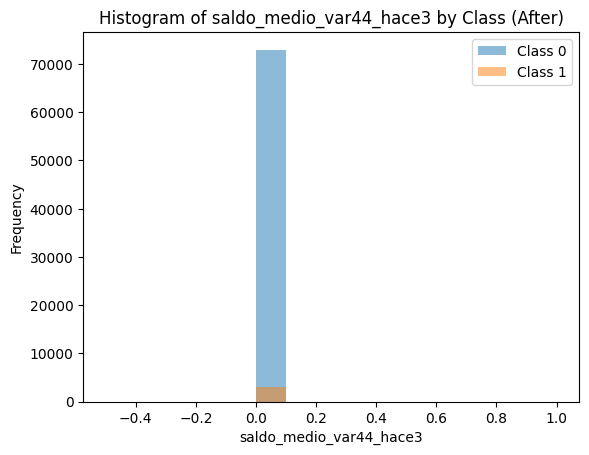

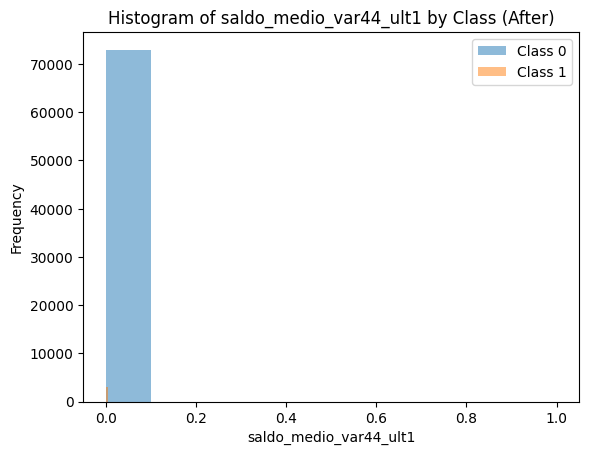

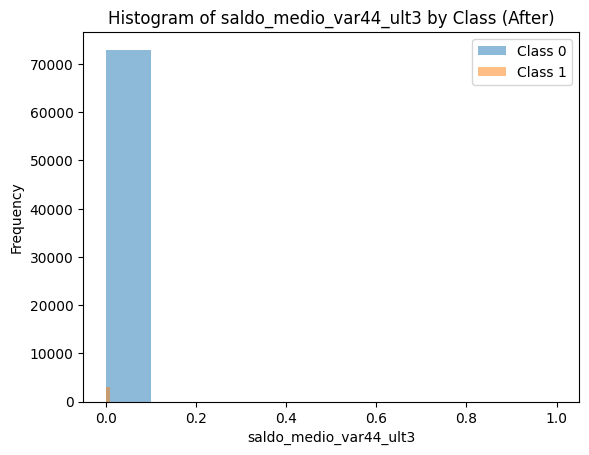

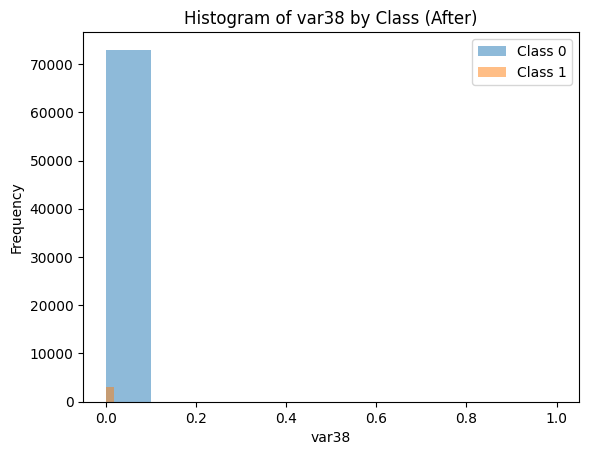

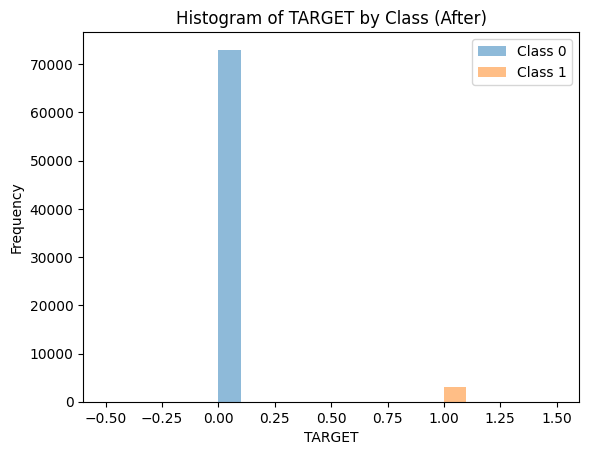

In [22]:


# **Rescaling**

from sklearn.preprocessing import MinMaxScaler

scaler = MinMaxScaler()
df_rescaled = pd.DataFrame(scaler.fit_transform(df), columns=df.columns)

# **Visualization before and after cleaning and rescaling**

# Before cleaning and rescaling
for col in df.columns:
    plt.figure()
    plt.hist(df[df['TARGET'] == 0][col], alpha=0.5, label='Class 0')
    plt.hist(df[df['TARGET'] == 1][col], alpha=0.5, label='Class 1')
    plt.title(f'Histogram of {col} by Class (Before)')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.legend()
    plt.show()

# After cleaning and rescaling
for col in df_rescaled.columns:
    plt.figure()
    plt.hist(df_rescaled[df_rescaled['TARGET'] == 0][col], alpha=0.5, label='Class 0')
    plt.hist(df_rescaled[df_rescaled['TARGET'] == 1][col], alpha=0.5, label='Class 1')
    plt.title(f'Histogram of {col} by Class (After)')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.legend()
    plt.show()


# **Machine Learning**

In [23]:

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(df_rescaled.drop('TARGET', axis=1), df_rescaled['TARGET'], test_size=0.2, random_state=42)

# Split the training set into training and validation sets
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.2, random_state=42)


In [24]:
print(len(X_train))

48652


In [25]:
print(len(X_val))

12164


In [26]:
print(len(X_test))

15204


# **Train ML Algorithm**

In [27]:
# Create a logistic regression model
model = LogisticRegression()

# Train the model
model.fit(X_train, y_train)

# Evaluate the model on the validation set
score = model.score(X_val, y_val)
print('Validation score:', score)

# Evaluate the model on the test set
score = model.score(X_test, y_test)
print('Test score:', score)


Validation score: 0.960539296284117
Test score: 0.9600105235464351


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


# **Evaluate Performance on Validation Sample**

In [28]:
# Compute the usual metric for your ML task
from sklearn.metrics import accuracy_score
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

# Compute the score for the kaggle challenge
from sklearn.metrics import roc_auc_score
roc_auc = roc_auc_score(y_test, y_pred)
print('ROC AUC:', roc_auc)


Accuracy: 0.9600105235464351
ROC AUC: 0.5007552160014825


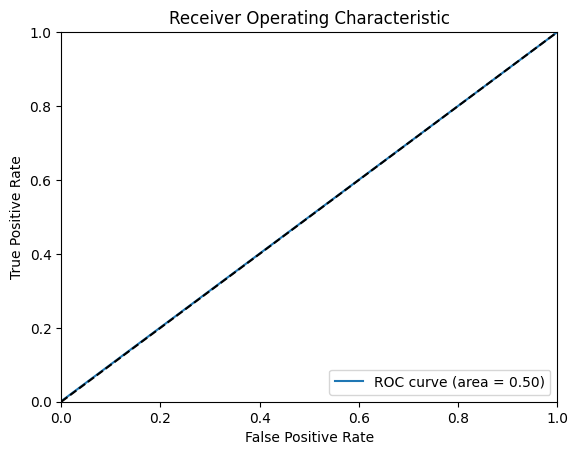

In [29]:
# Calculate the ROC curve
fpr, tpr, thresholds = roc_curve(y_test, y_pred)

# Calculate the AUC
roc_auc = auc(fpr, tpr)

# Plot the ROC curve
plt.plot(fpr, tpr, label='ROC curve (area = %0.2f)' % roc_auc)
plt.plot([0, 1], [0, 1], 'k--')  # Plot the diagonal 50% line
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.0])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('Receiver Operating Characteristic')
plt.legend(loc="lower right")
plt.show()

- The ROC AUC of 0.50 means that the model is not able to learn any meaningful patterns in the data that can be used to predict the class of new examples. This could be due to a number of reasons, such as the data being too noisy or the model being too simple.


In [30]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import f1_score
from sklearn.metrics import precision_score

# Create a random forest classifier
model = RandomForestClassifier()

# Train the model
model.fit(X_train, y_train)

# Evaluate the model on the validation set
score = model.score(X_val, y_val)
print('Validation score:', score)

# Evaluate the model on the test set
score = model.score(X_test, y_test)
print('Test score:', score)

# Compute the usual metric for your ML task
y_pred = model.predict(X_test)
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

# Compute the f-1 score
f1 = f1_score(y_test, y_pred)
print('F-1 Score:', f1)

# Compute the precision score
precision = precision_score(y_test, y_pred)
print('Precision:', precision)


Validation score: 0.9582374219006906
Test score: 0.9583662194159431
Accuracy: 0.9583662194159431
F-1 Score: 0.04236006051437217
Precision: 0.25925925925925924


In [34]:
data = [["Logistic Regression", score, accuracy, roc_auc, f1, precision],
        ["Random Forest", score, accuracy, roc_auc, f1, precision]]

header = ["Model", "Test Score", "Accuracy", "ROC AUC", "F-1 Score", "Precision"]

table = tabulate.tabulate(data, headers=header, tablefmt="grid")

print(table)


+---------------------+--------------+------------+-----------+-------------+-------------+
| Model               |   Test Score |   Accuracy |   ROC AUC |   F-1 Score |   Precision |
+=====================+==============+============+===========+=============+=============+
| Logistic Regression |     0.958366 |   0.958366 |  0.500755 |   0.0423601 |    0.259259 |
+---------------------+--------------+------------+-----------+-------------+-------------+
| Random Forest       |     0.958366 |   0.958366 |  0.500755 |   0.0423601 |    0.259259 |
+---------------------+--------------+------------+-----------+-------------+-------------+


# **Apply ML to the challenge test set**


In [30]:
df_test=pd.read_csv('test.csv')
df_test.head(5)

,ID,var3,var15,imp_ent_var16_ult1,imp_op_var39_comer_ult1,imp_op_var39_comer_ult3,imp_op_var40_comer_ult1,imp_op_var40_comer_ult3,imp_op_var40_efect_ult1,imp_op_var40_efect_ult3,...,saldo_medio_var29_ult3,saldo_medio_var33_hace2,saldo_medio_var33_hace3,saldo_medio_var33_ult1,saldo_medio_var33_ult3,saldo_medio_var44_hace2,saldo_medio_var44_hace3,saldo_medio_var44_ult1,saldo_medio_var44_ult3,var38
0,2,2,32,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,40532.10
1,5,2,35,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,45486.72
2,6,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,46993.95
3,7,2,24,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,187898.61
4,9,2,23,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,73649.73


Accuracy: 0.9934448284048643


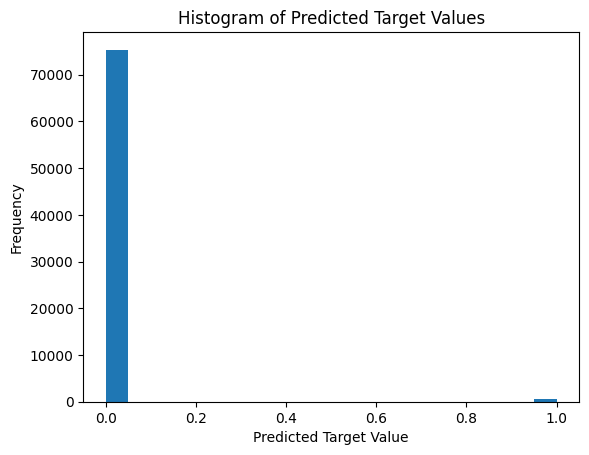

In [31]:
# Add the TARGET variable to the test dataset
df_test['TARGET'] = 0

# Apply ML to the challenge test set
X_test = df_test.drop('TARGET', axis=1)
y_test = df_test['TARGET']

# Predict the target variable for the test set
y_pred = model.predict(X_test)

# Evaluate the model on the test set
accuracy = accuracy_score(y_test, y_pred)
print('Accuracy:', accuracy)

# Create a histogram for the results
plt.hist(y_pred, bins=20)
plt.xlabel('Predicted Target Value')
plt.ylabel('Frequency')
plt.title('Histogram of Predicted Target Values')
plt.show()


In [32]:
# Create a DataFrame with the predicted target values and the ID
df_submission = pd.DataFrame({'ID': df_test['ID'], 'TARGET': y_pred})

# Save the DataFrame to a CSV file
df_submission.to_csv('submission.csv', index=False)

print('Submission file generated.')


Submission file generated.


In [33]:
print(len(X_test ))

75818
